In [1]:
# This is necessary to recognize the modules
import os
import sys
from decimal import Decimal

import pandas as pd

root_path = os.path.abspath(os.path.join(os.getcwd(), '../..'))
sys.path.append(root_path)

In [2]:
from data_sources.clob import CLOBDataSource

# Get trading rules and candles
clob = CLOBDataSource()

In [3]:
# Constants
CONNECTOR_NAME = "binance_perpetual"
INTERVAL = "1m"
DAYS = 20

# Features configuration
VOLATILITY_WINDOW = 100
BOLLINGER_LENGTH = 200
BOLLINGER_STD = 2.0

# Download data
- Get trading rules
- Get candles for the last x days

In [4]:
import asyncio

trading_rules = await clob.get_trading_rules(CONNECTOR_NAME)
trading_pairs = trading_rules.filter_by_quote_asset("USDT")\
    .filter_by_min_notional_size(Decimal("5"))\
    .get_all_trading_pairs()

2024-08-14 02:42:43,646 - asyncio - ERROR - Unclosed client session
client_session: <aiohttp.client.ClientSession object at 0x147b0f4f0>
2024-08-14 02:42:43,648 - asyncio - ERROR - Unclosed connector
connections: ['[(<aiohttp.client_proto.ResponseHandler object at 0x1059edfc0>, 14972.639625375)]']
connector: <aiohttp.connector.TCPConnector object at 0x147b0f070>


In [5]:


tasks = [clob.get_candles_last_days(
    connector_name=CONNECTOR_NAME,
    trading_pair=trading_pair,
    interval=INTERVAL,
    days=DAYS,
) for trading_pair in trading_pairs[:5]]
candles = await asyncio.gather(*tasks)
candles = {trading_pair: candle for trading_pair, candle in zip(trading_pairs, candles)}

2024-08-14 02:42:55,387 - asyncio - ERROR - Unclosed client session
client_session: <aiohttp.client.ClientSession object at 0x147a9e050>
2024-08-14 02:42:55,387 - asyncio - ERROR - Unclosed connector
connections: ['[(<aiohttp.client_proto.ResponseHandler object at 0x147a09f60>, 14984.345445541)]']
connector: <aiohttp.connector.TCPConnector object at 0x147a9e080>
2024-08-14 02:42:55,407 - asyncio - ERROR - Unclosed client session
client_session: <aiohttp.client.ClientSession object at 0x147a9d8a0>
2024-08-14 02:42:55,407 - asyncio - ERROR - Unclosed connector
connections: ['[(<aiohttp.client_proto.ResponseHandler object at 0x147a0aaa0>, 14984.382331)]']
connector: <aiohttp.connector.TCPConnector object at 0x147a9d8d0>
2024-08-14 02:42:55,425 - asyncio - ERROR - Unclosed client session
client_session: <aiohttp.client.ClientSession object at 0x147a9ead0>
2024-08-14 02:42:55,426 - asyncio - ERROR - Unclosed connector
connections: ['[(<aiohttp.client_proto.ResponseHandler object at 0x147a0a

In [6]:
candles.keys()

dict_keys(['PEOPLE-USDT', 'METIS-USDT', 'MANA-USDT', 'COMP-USDT', 'MEW-USDT'])

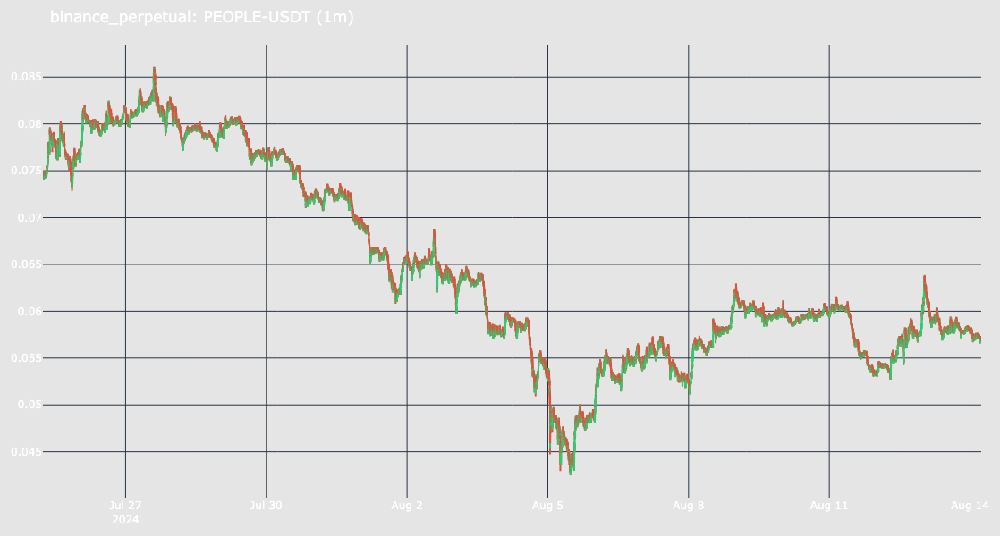

In [7]:
trading_pair = "PEOPLE-USDT"
candles[trading_pair].plot(type="candles")

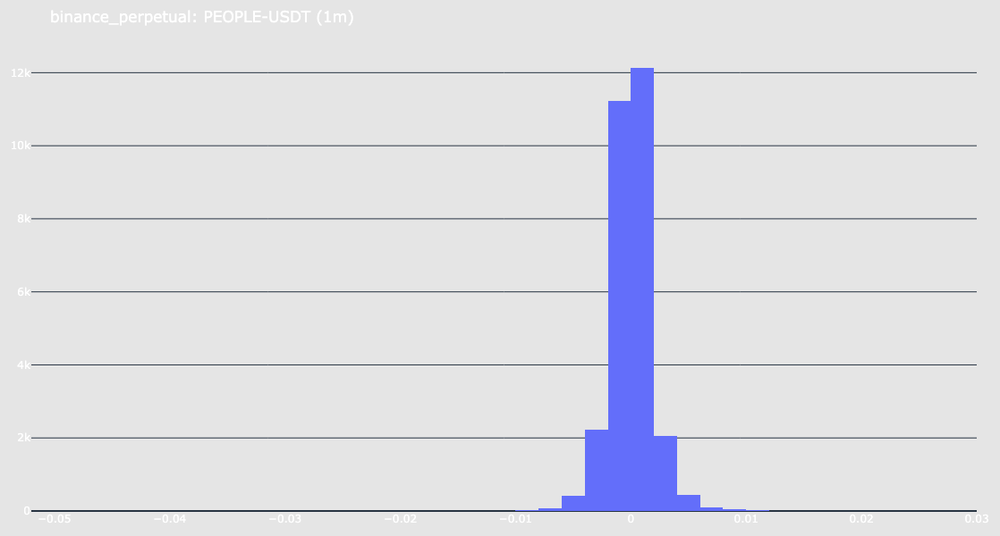

In [8]:
candles[trading_pair].plot(type="returns")

In [16]:
import pandas_ta as ta

def apply_signal(x):
    if x >= 1:
        return -1
    elif x <= 0:
        return 1
    else:
        return 0


In [38]:
import pandas as pd

# Assuming df has already been created and processed as per your initial steps
df = candles[trading_pair].data
df.ta.bbands(length=BOLLINGER_LENGTH, std=BOLLINGER_STD, append=True)
df["signal"] = df[f"BBP_{BOLLINGER_LENGTH}_{BOLLINGER_STD}"].apply(lambda x: apply_signal(x))
df["out_of_bounds"] = df["signal"].diff().fillna(0)
df.loc[df["signal"] == 0, "out_of_bounds"] = 0

# Create df_filtered for values where out_of_bounds is not 0
df_filtered = df[df["out_of_bounds"] != 0].copy()
df["score"] = 0

score = (df.loc[df["out_of_bounds"] != 0, "out_of_bounds"].shift() != df.loc[df["out_of_bounds"] != 0, "out_of_bounds"]).cumsum()

n_out_of_bounds = len(df[df["out_of_bounds"] != 0])

df.loc[df_filtered.index, "score"] = score
df_filtered = df[df["score"] != 0].copy()
df_filtered["changes"] = df_filtered["score"].shift() != df_filtered["score"]
timestamps_change = df_filtered[df_filtered["changes"] != 0].index

prices = []

for i, timestamp in enumerate(timestamps_change):
    if i == len(timestamps_change) - 1:
        break
    next_timestamp = timestamps_change[i + 1]
    df_temp = df[timestamp:next_timestamp].copy()
    max_price = df_temp["high"].max()
    min_price = df_temp["low"].min()
    start_price = df_temp["close"].iloc[0]
    end_price = df_temp["close"].iloc[-1]
    signal = df_temp["signal"].iloc[0]
    if signal == 1:
        reversion_price = min(end_price, max_price)
        worst_deviation = abs(min_price - start_price) / start_price
        total_reversion = (reversion_price - start_price) / start_price
    elif signal == -1:
        reversion_price = max(end_price, min_price)
        worst_deviation = abs(max_price - start_price)  / start_price
        total_reversion = -1 * (reversion_price - start_price) / start_price
    else:
        worst_deviation = 0
        total_reversion = 0

    prices.append({
        "start_timestamp": timestamp,
        "end_timestamp": next_timestamp,
        "start_price": start_price,
        "max_price": max_price,
        "min_price": min_price,
        "end_price": end_price,
        "signal": signal,
        "worst_deviation": worst_deviation,
        "total_reversion": total_reversion,
    })
prices

[{'start_timestamp': Timestamp('2024-07-25 09:13:00'),
  'end_timestamp': Timestamp('2024-07-25 12:26:00'),
  'start_price': 0.07793,
  'max_price': 0.07967,
  'min_price': 0.077,
  'end_price': 0.07736,
  'signal': -1,
  'worst_deviation': 0.022327730014115303,
  'total_reversion': 0.007314256383934314},
 {'start_timestamp': Timestamp('2024-07-25 12:26:00'),
  'end_timestamp': Timestamp('2024-07-25 14:29:00'),
  'start_price': 0.07736,
  'max_price': 0.07917,
  'min_price': 0.07613,
  'end_price': 0.07911,
  'signal': 1,
  'worst_deviation': 0.015899689762150917,
  'total_reversion': 0.022621509824198572},
 {'start_timestamp': Timestamp('2024-07-25 14:29:00'),
  'end_timestamp': Timestamp('2024-07-25 17:34:00'),
  'start_price': 0.07911,
  'max_price': 0.08022,
  'min_price': 0.07621,
  'end_price': 0.07625,
  'signal': -1,
  'worst_deviation': 0.01403109594235874,
  'total_reversion': 0.036152193148780196},
 {'start_timestamp': Timestamp('2024-07-25 17:34:00'),
  'end_timestamp': Tim

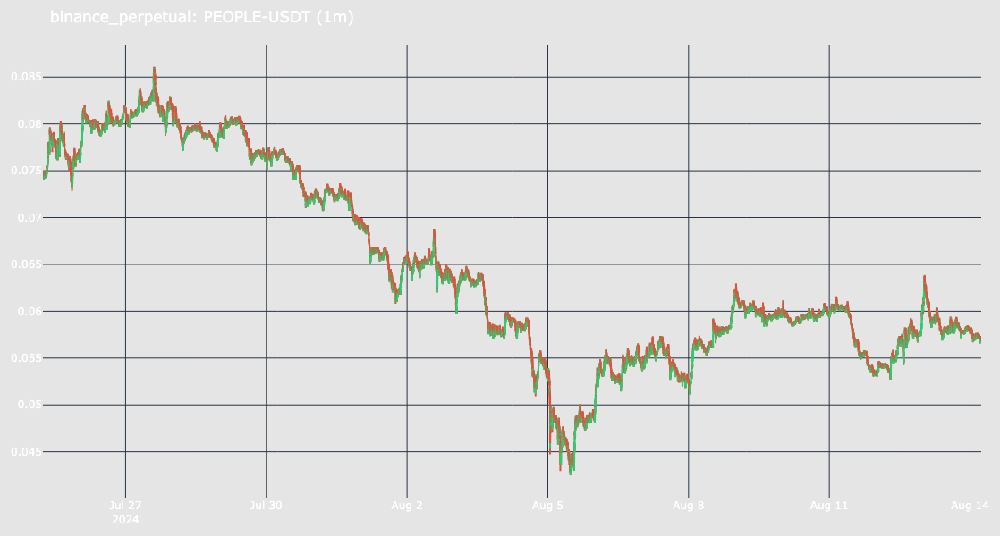

In [39]:
candles[trading_pair].plot(type="candles")

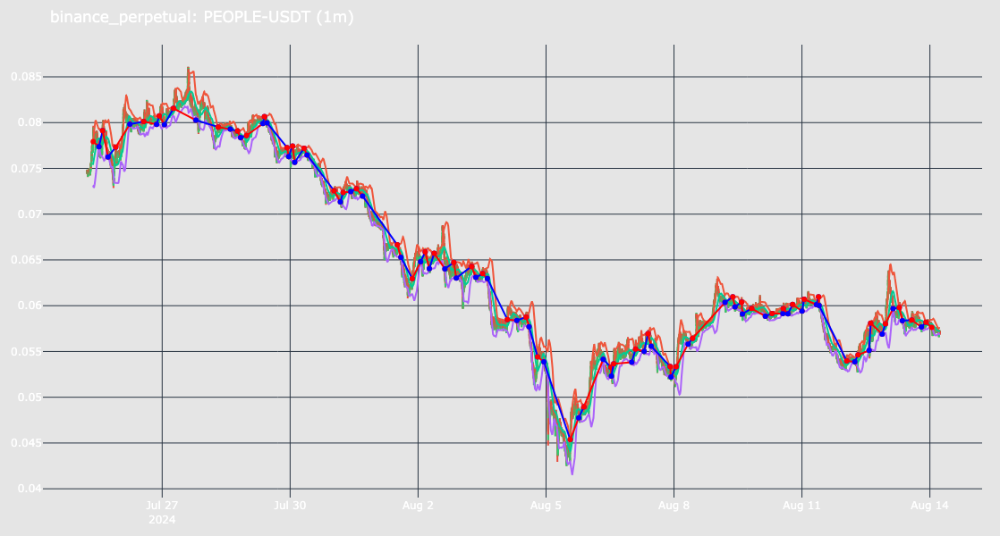

In [40]:
import plotly.graph_objects as go


candles_figure = candles[trading_pair].fig()
candles_figure.add_trace(go.Scatter(x=df.index,
                                    y=df[f"BBU_{BOLLINGER_LENGTH}_{BOLLINGER_STD}"])
                        )
candles_figure.add_trace(go.Scatter(x=df.index,
                                    y=df[f"BBM_{BOLLINGER_LENGTH}_{BOLLINGER_STD}"])
                        )
candles_figure.add_trace(go.Scatter(x=df.index,
                                    y=df[f"BBL_{BOLLINGER_LENGTH}_{BOLLINGER_STD}"])
                        )
for price in prices:
    # Add line from start to end price
    candles_figure.add_trace(go.Scatter(
        x=[price['start_timestamp'], price['end_timestamp']],
        y=[price['start_price'], price['end_price']],
        mode='lines+markers',
        name=f"Signal {price['signal']}",
        line=dict(color='blue' if price['signal'] == 1 else 'red')
    ))
candles_figure.show()

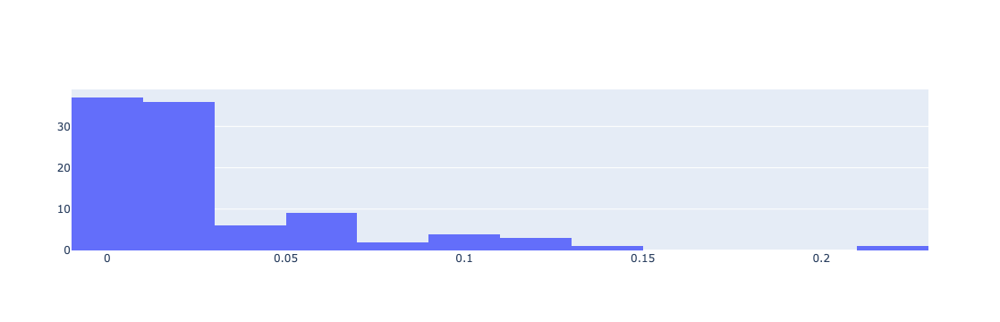

In [41]:
worst_deviations = [price["worst_deviation"] for price in prices]
fig = go.Figure(go.Histogram(x=worst_deviations))
fig.show()

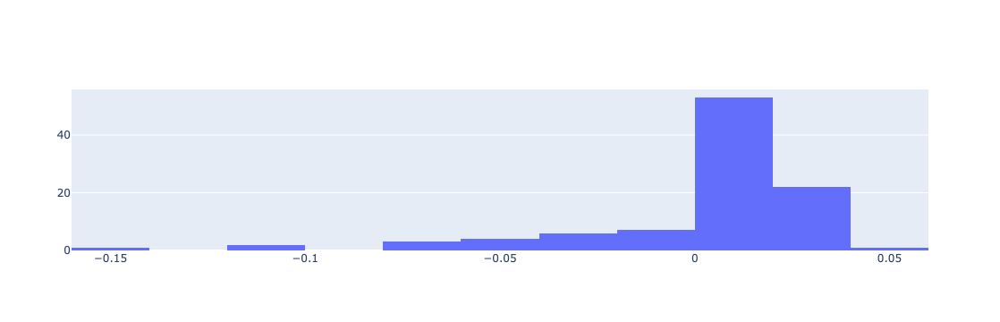

In [43]:
total_reversion = [price["total_reversion"] for price in prices]
fig = go.Figure(go.Histogram(x=total_reversion))
fig.show()

In [47]:
fake_reversions = len([r for r in total_reversion if r < 0])
right_reversions = len([r for r in total_reversion if r > 0])
print(f"Fake reversions: {fake_reversions/len(total_reversion)} | Right reversions: {right_reversions/len(total_reversion)}")

Fake reversions: 0.23232323232323232 | Right reversions: 0.7575757575757576


In [139]:
n_out_of_bounds

647

In [141]:
df["timestamp"].min()

1721884140.0

In [142]:
df["timestamp"].max()

1723612080.0

In [ ]:
candles_figure = candles["NEAR-USDT"].plot(type="candles")

In [8]:
from features.candles.trend import TrendConfig
from features.candles.volatility import VolatilityConfig
from features.candles.volume import VolumeConfig
from research_notebooks.dneitor.utils import generate_report

report = generate_report(
    candles=candles,
    volatility_config=VolatilityConfig(window=VOLATILITY_WINDOW),
    trend_config=TrendConfig(short_window=TREND_SHORT_WINDOW, long_window=TREND_LONG_WINDOW),
    volume_config=VolumeConfig(short_window=VOLUME_SHORT_WINDOW, long_window=VOLUME_LONG_WINDOW))
report

,trading_pair,mean_volatility,mean_natr,mean_bb_width,latest_trend,average_volume_per_hour,normalized_score
0,SAGA-FDUSD,0.00917747,0.0099645,15.23943085,-0.47102794,6984.21180698,0.0001603
1,RUNE-FDUSD,0.00597329,0.00494119,9.88064932,0.19212321,2832.9203333,0.00004213
2,APT-FDUSD,0.00543456,0.00411022,8.96720093,-0.55098441,2747.97759083,0.00003708
3,PENDLE-FDUSD,0.00818809,0.00797987,13.39666541,-0.01009972,9392.65042293,0.00018947
4,UNI-FDUSD,0.00533546,0.00504639,7.59473288,-0.0063055,3620.25375141,0.00004141
...,...,...,...,...,...,...,...
89,FTM-FDUSD,0.00664541,0.00687199,10.09670887,0.53210129,11199.96966024,0.00017033
90,USTC-FDUSD,0.00675541,0.00591688,9.06198156,-0.04747228,2140.19319525,0.00002921
91,NOT-FDUSD,0.00709682,0.00975348,10.64062097,-0.04278873,94618.15934595,0.00151792
92,AR-FDUSD,0.00742243,0.00569872,10.71625575,-0.86434842,4955.6810518,0.00007994


In [9]:
from research_notebooks.dneitor.utils import filter_top_markets

TOP_X_MARKETS = 10  # Number of top markets to select
# Assuming the `top_markets` DataFrame has been generated as shown in the previous steps
# Constants
TOTAL_AMOUNT = 3000  # General total amount for all markets
MIN_AMOUNT_PER_MARKET = 200  # Minimum amount per market
ACTIVATION_BOUNDS = 0.002  # Input activation bounds
MAX_OPEN_ORDERS = 1  # Input max open orders for each market

# Example values
TAKE_PROFIT_MULTIPLIER = 0.3  # Multiplier for take profit based on NATR
AMOUNTS_QUOTE_PCT = [0.1, 0.1, 0.1, 0.1, 0.2, 0.2]  # Weights for each cluster
top_markets = filter_top_markets(report_df=report, top_x=TOP_X_MARKETS, min_volume_usd=2000, min_atr=0.008, trend_threshold=-0.5)
top_markets

,trading_pair,mean_volatility,mean_natr,mean_bb_width,latest_trend,average_volume_per_hour,normalized_score
50,SOL-FDUSD,0.00596109,0.008907,8.90389137,0.13651798,18082290.75262372,0.24282005
51,PEPE-FDUSD,0.00739293,0.01077617,10.81121762,-0.15670191,217099.36540599,0.0035398
14,WIF-FDUSD,0.00871553,0.01182773,13.24538367,-0.06146667,94792.75271685,0.0018928
91,NOT-FDUSD,0.00709682,0.00975348,10.64062097,-0.04278873,94618.15934595,0.00151792
76,BOME-FDUSD,0.00798152,0.01103037,12.32203936,-0.26465712,48169.28797468,0.00089479
85,NEAR-FDUSD,0.00635341,0.00843262,9.36013767,-0.02615036,53337.5837876,0.00075265
77,ENA-FDUSD,0.00709069,0.0082681,11.13436812,-0.00370284,43823.47585238,0.00073515
29,1000SATS-FDUSD,0.0092606,0.01253566,14.16342755,0.0915444,30588.99514634,0.00065311
49,BONK-FDUSD,0.0074623,0.00954754,10.22275986,-0.2559129,37908.33574839,0.0005843
11,IO-FDUSD,0.00822603,0.00991772,13.32152046,0.14764992,23429.85420444,0.00047025


In [10]:
from research_notebooks.dneitor.utils import generate_config, dump_dict_to_yaml

strategy_config = generate_config(
    id="dneitor-binance_0.4",
    connector_name=CONNECTOR_NAME,
    candles=candles,
    top_markets=top_markets,
    total_amount=TOTAL_AMOUNT,
    amounts_quote_pct=AMOUNTS_QUOTE_PCT,
    activation_bounds=ACTIVATION_BOUNDS,
    take_profit_multiplier=TAKE_PROFIT_MULTIPLIER,
    max_open_orders=MAX_OPEN_ORDERS,
    min_amount_per_market=MIN_AMOUNT_PER_MARKET,
)
dump_dict_to_yaml("configs/", strategy_config)